In [1]:
import cv2
import h5py
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm as c
from keras.models import model_from_json

In [2]:
def load_model():
    # Function to load and return neural network model 
    json_file = open('models/Model.json', 'r')
    loaded_model_json = json_file.read()
    json_file.close()
    loaded_model = model_from_json(loaded_model_json)
    loaded_model.load_weights("weights/model_A_weights.h5")
    return loaded_model

def create_img(path):
    #Function to load,normalize and return image 
    print(path)
    im = Image.open(path).convert('RGB')
    
    im = np.array(im)
    
    im = im/255.0
    
    im[:,:,0]=(im[:,:,0]-0.485)/0.229
    im[:,:,1]=(im[:,:,1]-0.456)/0.224
    im[:,:,2]=(im[:,:,2]-0.406)/0.225


    im = np.expand_dims(im,axis  = 0)
    return im

In [3]:
def predict(path):
    #Function to load image,predict heat map, generate count and return (count , image , heat map)
    model = load_model()
    image = create_img(path)
    ans = model.predict(image)
#     print(ans)
    count = (int)(np.sum(ans)+1)
    return count,image,ans

In [9]:
from datetime import timedelta
import cv2
import numpy as np
import os

In [10]:
SAVING_FRAMES_PER_SECOND = 10

In [11]:
def format_timedelta(td):
    """Utility function to format timedelta objects in a cool way (e.g 00:00:20.05) 
    omitting microseconds and retaining milliseconds"""
    result = str(td)
    try:
        result, ms = result.split(".")
    except ValueError:
        return (result + ".00").replace(":", "-")
    ms = int(ms)
    ms = round(ms / 1e4)
    return f"{result}.{ms:02}".replace(":", "-")


def get_saving_frames_durations(cap, saving_fps):
    """A function that returns the list of durations where to save the frames"""
    s = []
    # get the clip duration by dividing number of frames by the number of frames per second
    clip_duration = cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS)
    # use np.arange() to make floating-point steps
    for i in np.arange(0, clip_duration, 1 / saving_fps):
        s.append(i)
    return s

In [12]:
def getFrames(video_file):
    filename, _ = os.path.splitext(video_file)
    filename += "-opencv"
    # make a folder by the name of the video file
    if not os.path.isdir(filename):
        os.mkdir(filename)
    # read the video file    
    cap = cv2.VideoCapture(video_file)
    # get the FPS of the video
    fps = cap.get(cv2.CAP_PROP_FPS)
    # if the SAVING_FRAMES_PER_SECOND is above video FPS, then set it to FPS (as maximum)
    saving_frames_per_second = min(fps, SAVING_FRAMES_PER_SECOND)
    # get the list of duration spots to save
    saving_frames_durations = get_saving_frames_durations(cap, saving_frames_per_second)
    # start the loop
    count = 0
    while True:
        is_read, frame = cap.read()
        if not is_read:
            # break out of the loop if there are no frames to read
            break
        # get the duration by dividing the frame count by the FPS
        frame_duration = count / fps
        try:
            # get the earliest duration to save
            closest_duration = saving_frames_durations[0]
        except IndexError:
            # the list is empty, all duration frames were saved
            break
        if frame_duration >= closest_duration:
            # if closest duration is less than or equals the frame duration, 
            # then save the frame
            frame_duration_formatted = format_timedelta(timedelta(seconds=frame_duration))
            cv2.imwrite(os.path.join(filename, f"frame{frame_duration_formatted}.jpg"), frame) 
            # drop the duration spot from the list, since this duration spot is already saved
            try:
                saving_frames_durations.pop(0)
            except IndexError:
                pass
        # increment the frame count
        count += 1
        



In [15]:
getFrames('D:/Downloads/CSRNet-keras-master/viddata/2.mp4')

In [51]:
x = [23, 52, 61, 95, 82, 195, 47, 62, 36, 181, 163, 512, 48, 29, 57, 92, 71, 234, 277, 15, 89, 300, 239, 79, 215, 38, 207, 61, 92, 51, 176, 43, 197, 41, 166, 156, 42, 89, 48, 330, 31, 41, 106, 28, 158, 90, 72, 84, 35, 265]
pred_val = 1000

testing/IMG_1.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  7.0


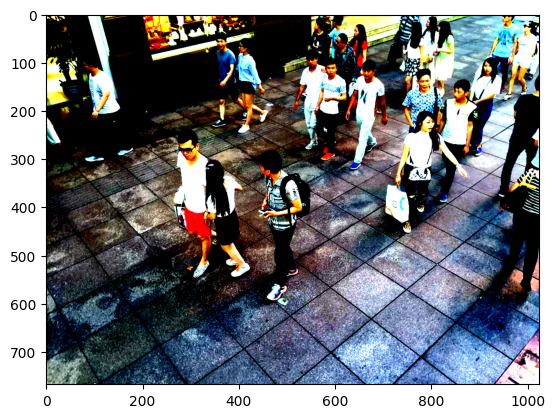

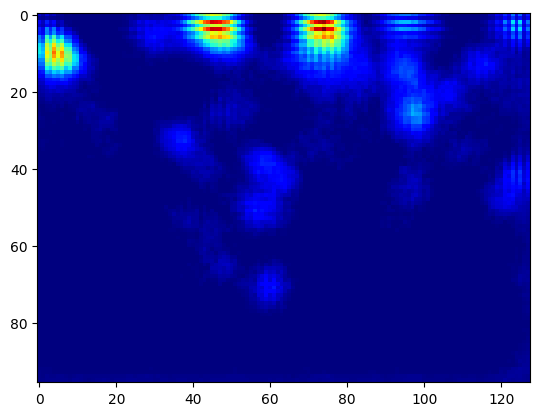

testing/IMG_2.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  26.0


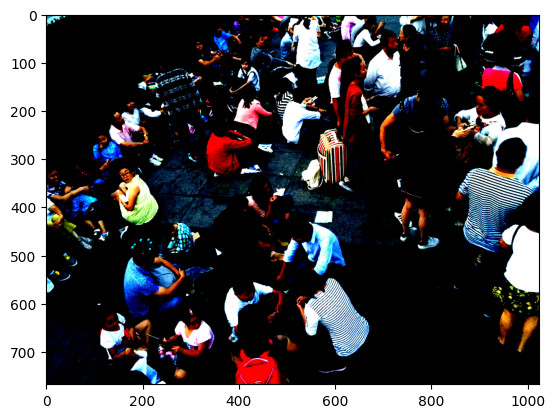

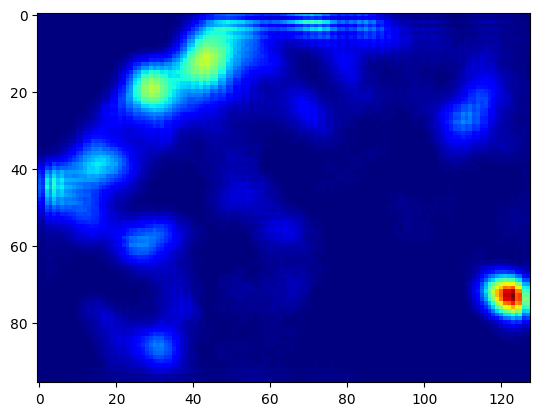

testing/IMG_3.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  16.0


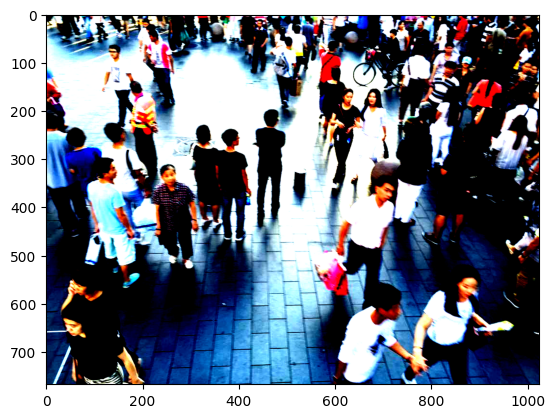

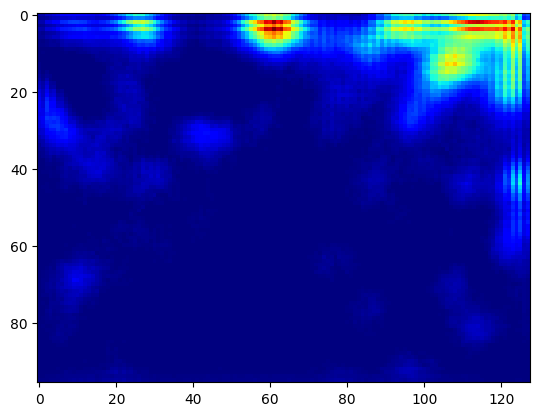

testing/IMG_4.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  26.0


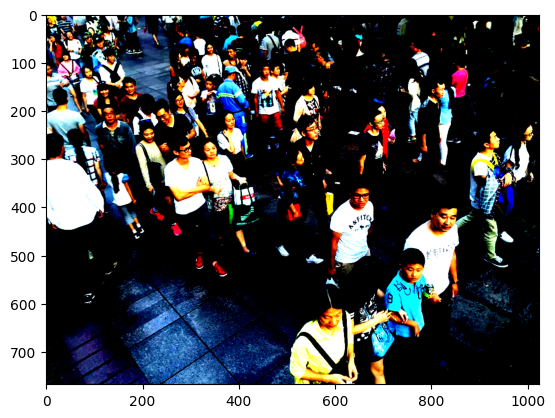

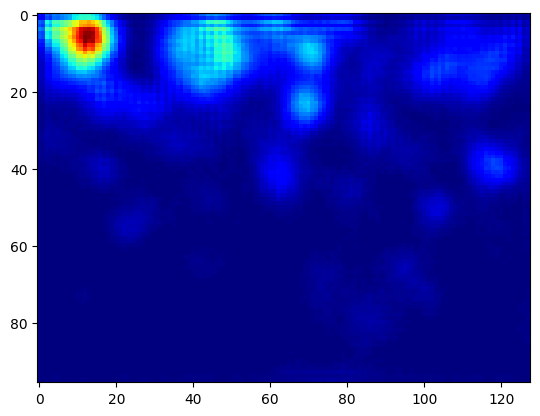

testing/IMG_5.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  16.0


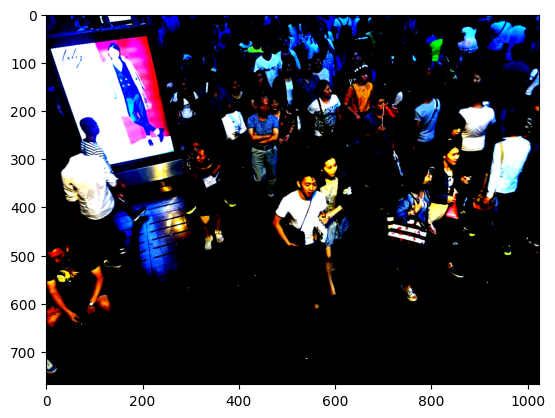

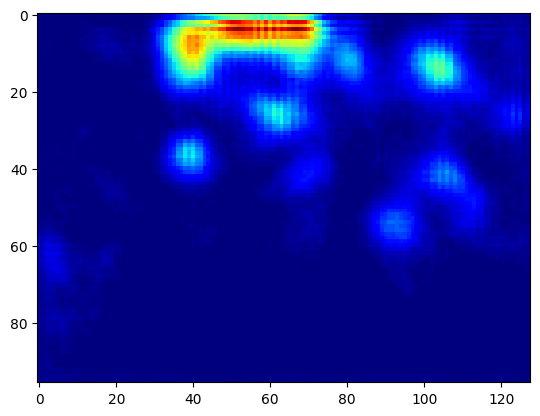

testing/IMG_6.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  86.0


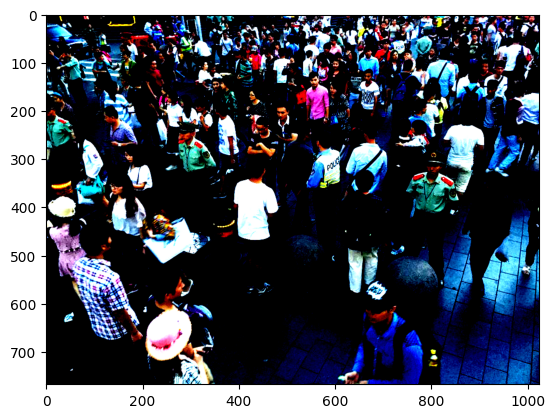

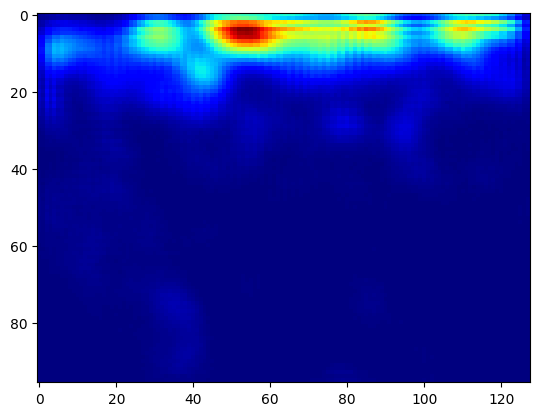

testing/IMG_7.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  17.0


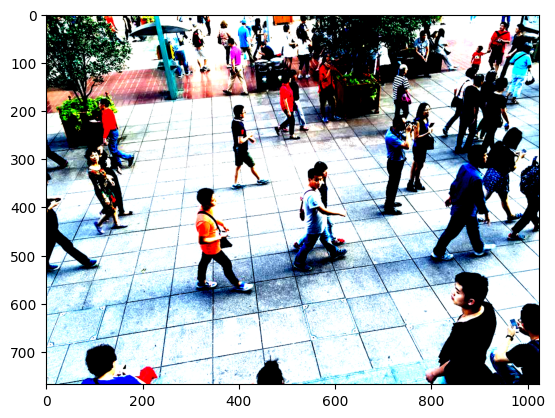

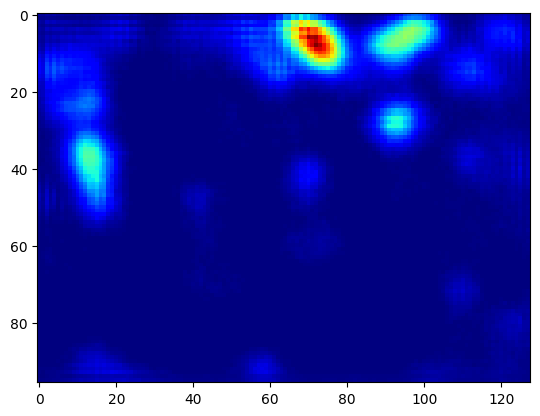

testing/IMG_8.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  19.0


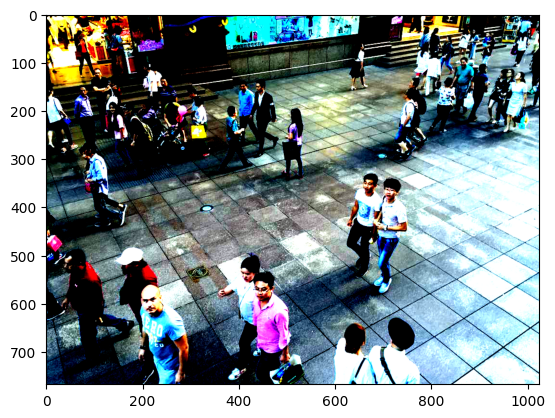

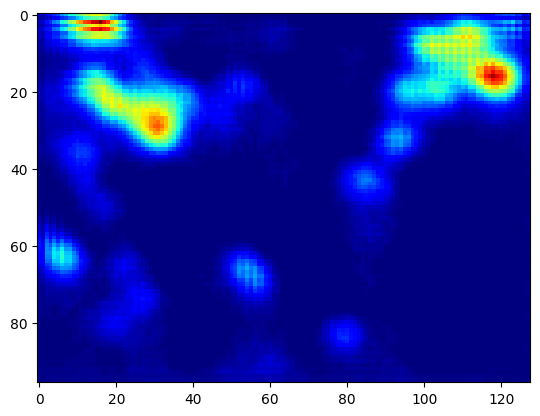

testing/IMG_9.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  11.0


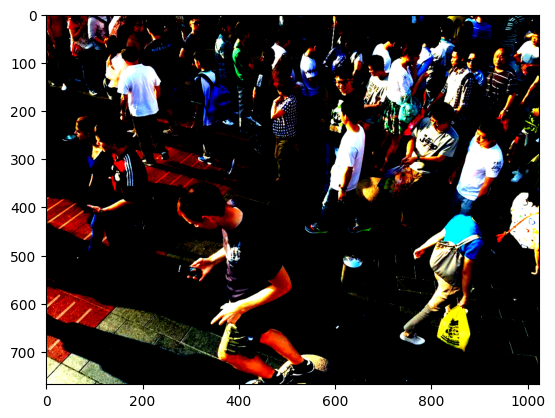

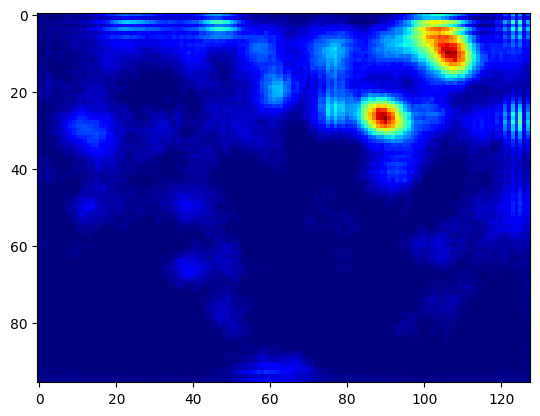

testing/IMG_10.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  47.0


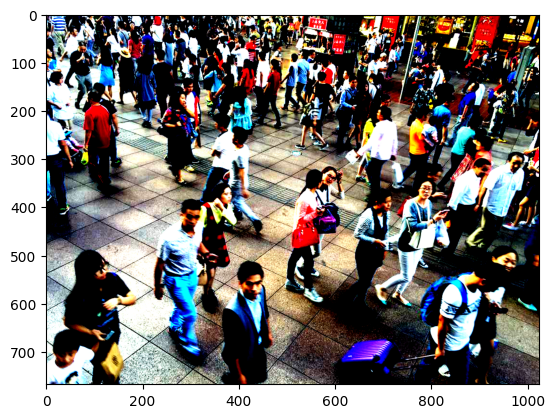

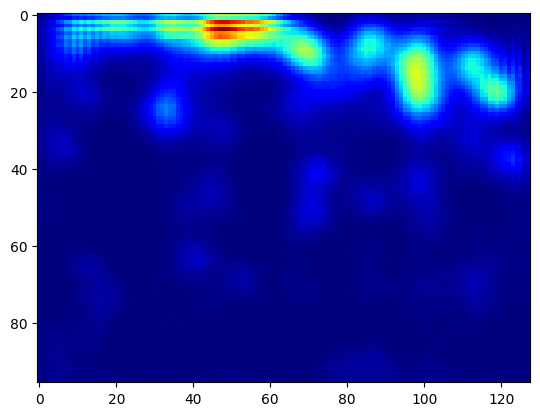

testing/IMG_11.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  56.0


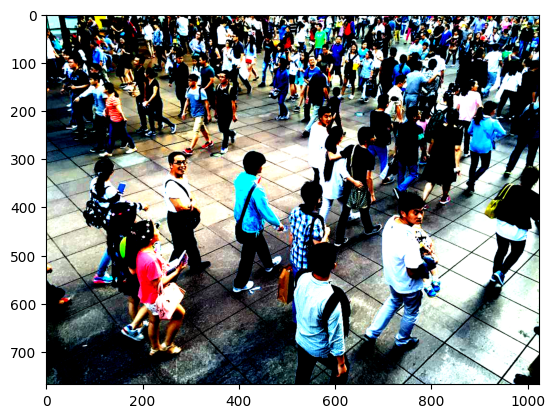

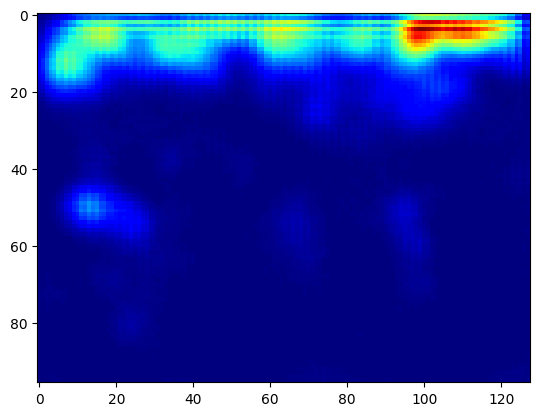

testing/IMG_12.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  138.0


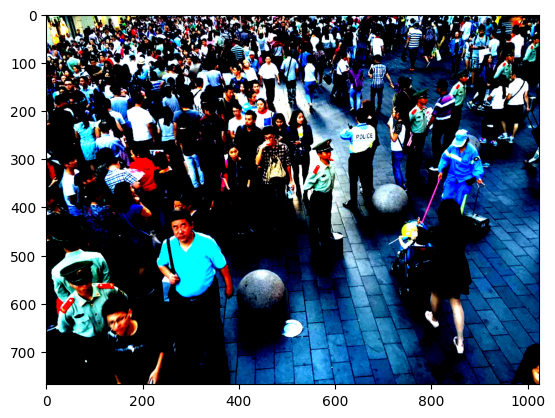

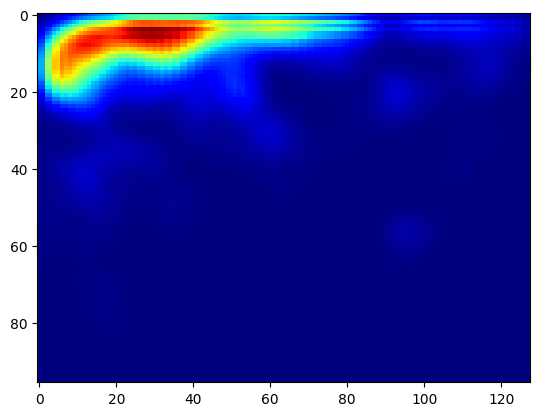

testing/IMG_13.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  190.0


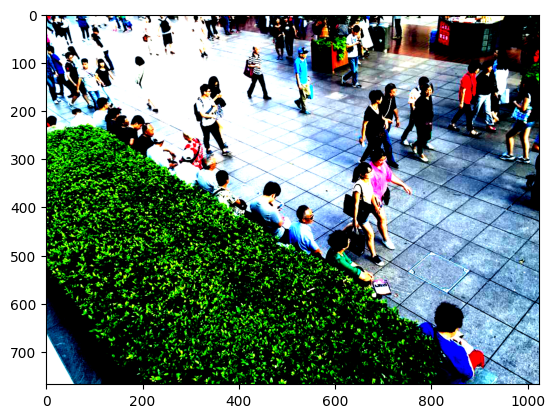

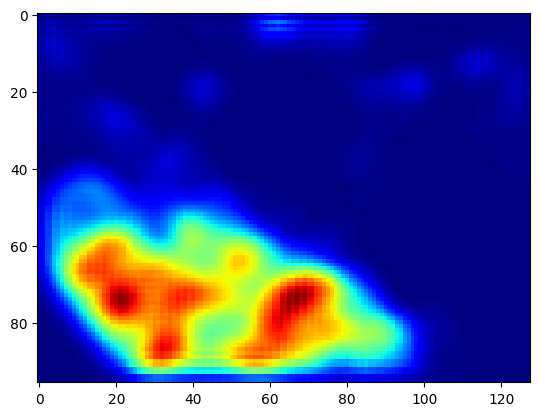

testing/IMG_14.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  14.0


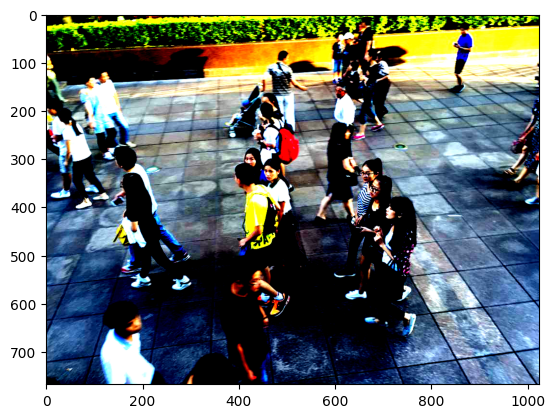

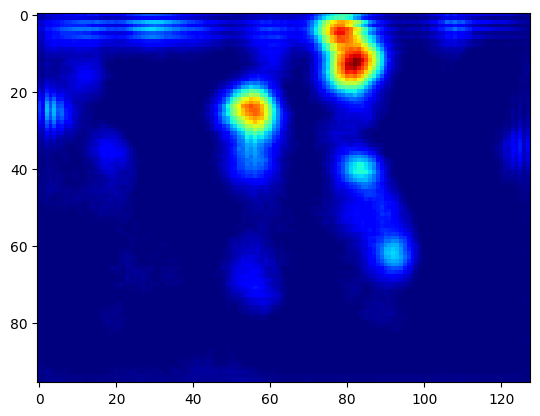

testing/IMG_15.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  10.0


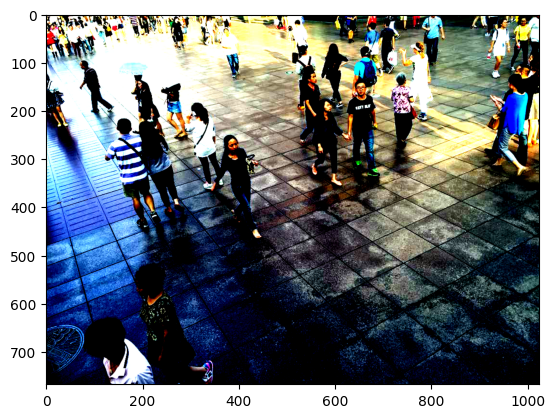

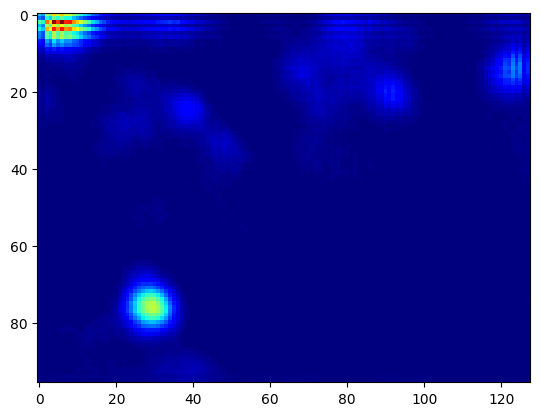

testing/IMG_16.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  28.0


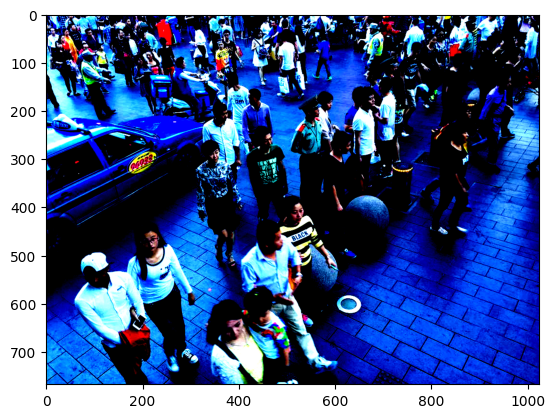

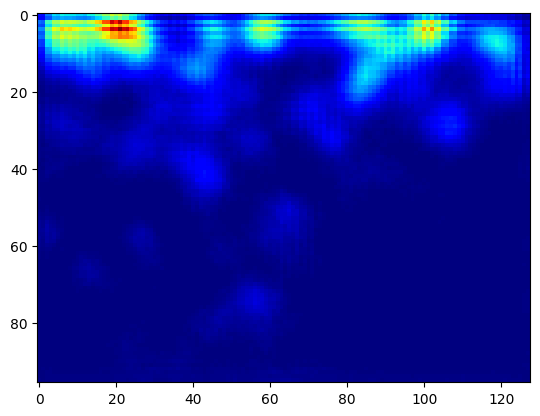

testing/IMG_17.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  57.0


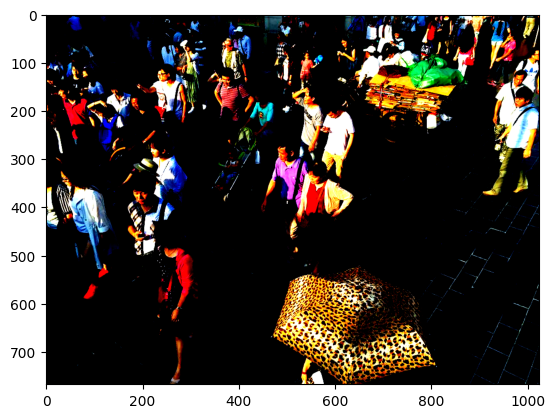

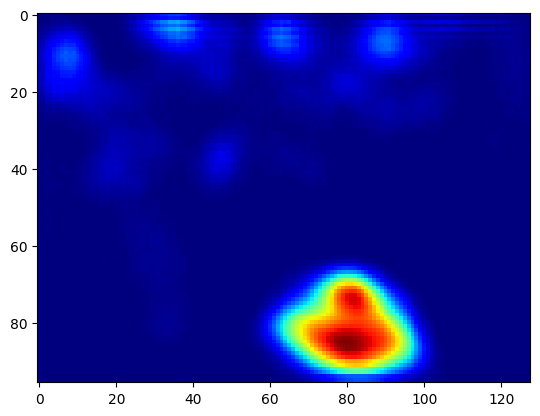

testing/IMG_18.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  67.0


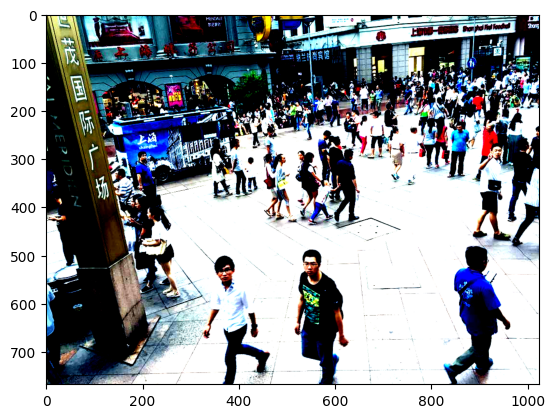

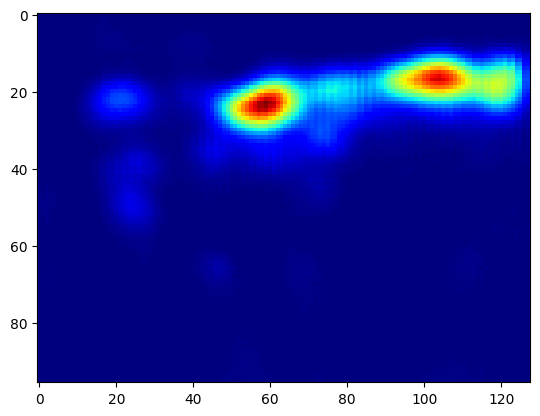

testing/IMG_19.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  75.0


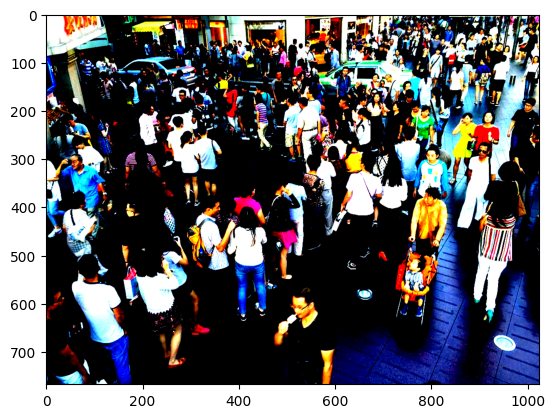

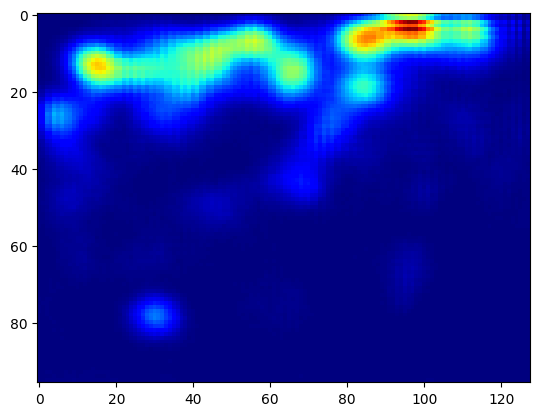

testing/IMG_20.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  8.0


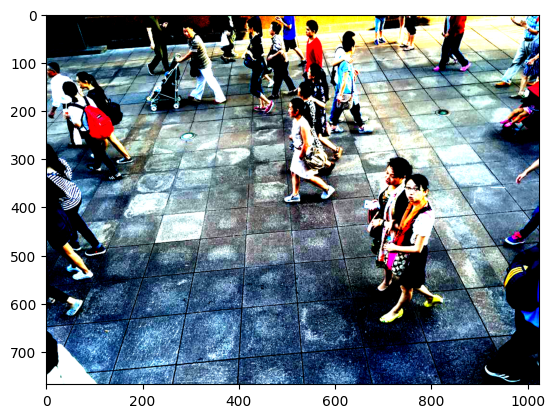

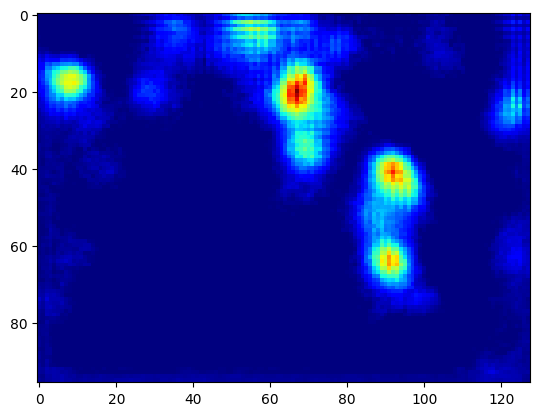

testing/IMG_21.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  27.0


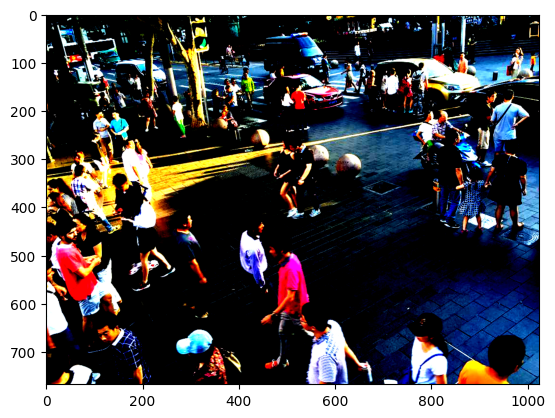

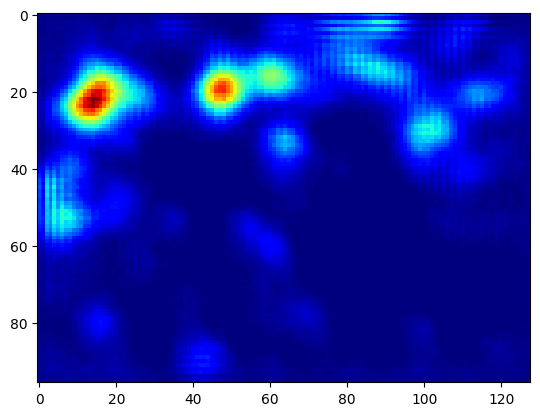

testing/IMG_22.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  83.0


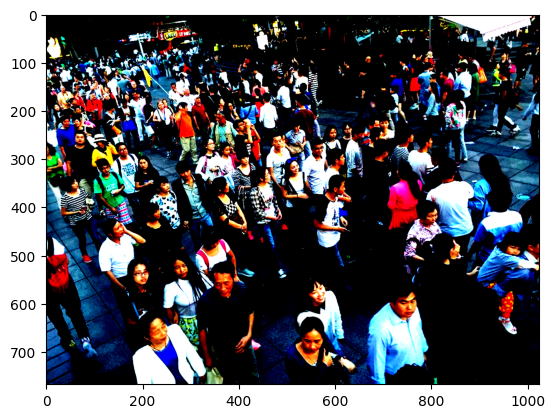

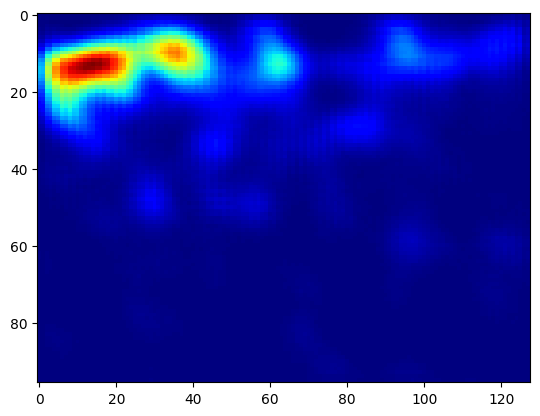

testing/IMG_23.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  68.0


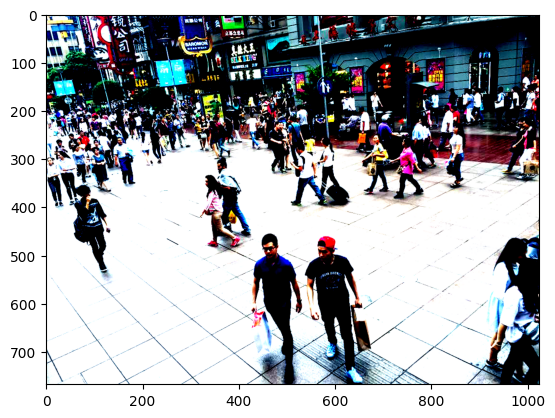

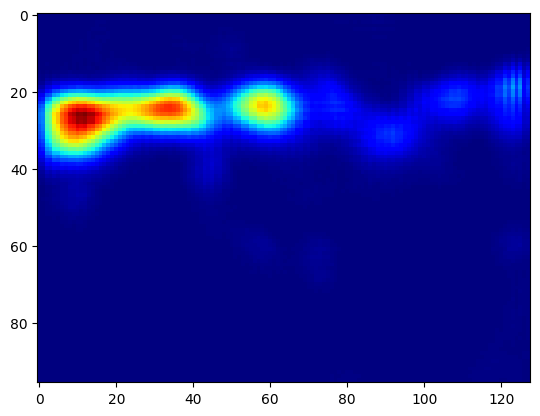

testing/IMG_24.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  17.0


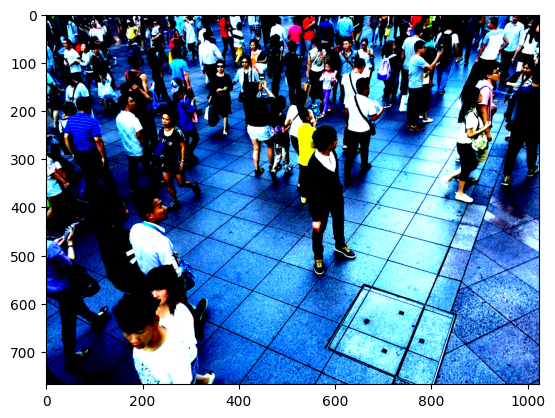

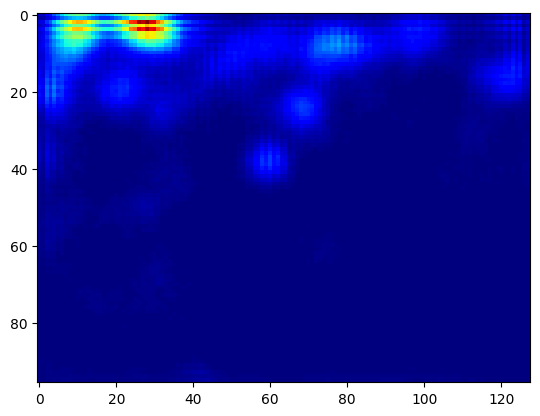

testing/IMG_25.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  82.0


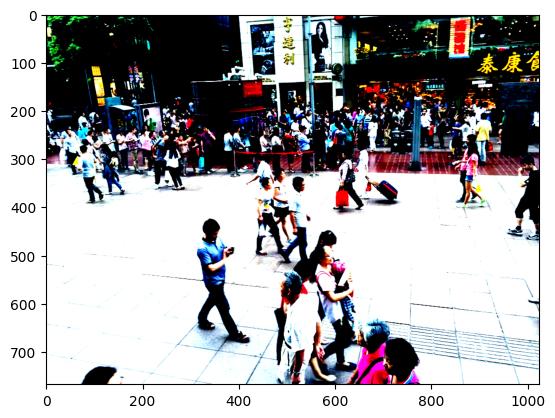

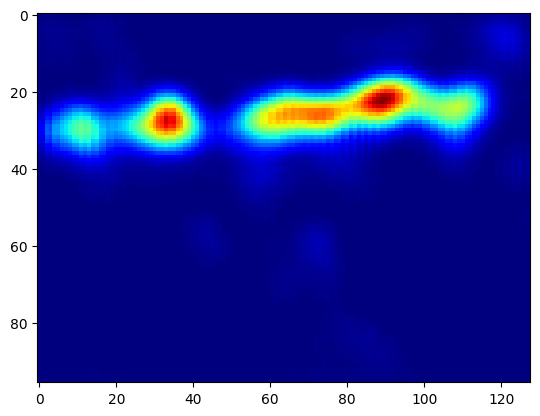

testing/IMG_26.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  11.0


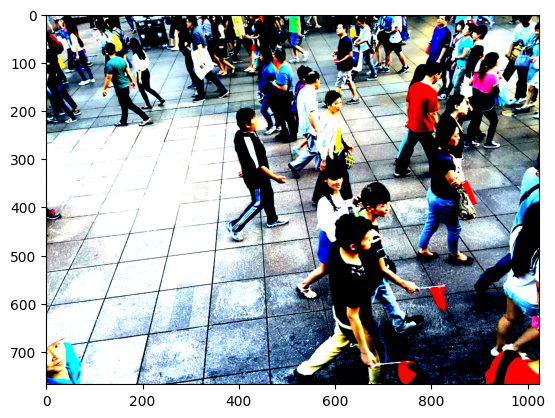

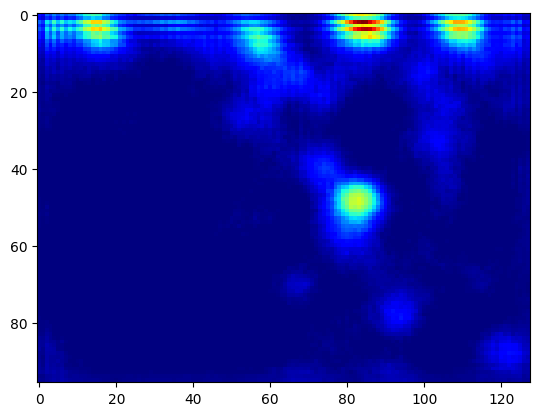

testing/IMG_27.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  82.0


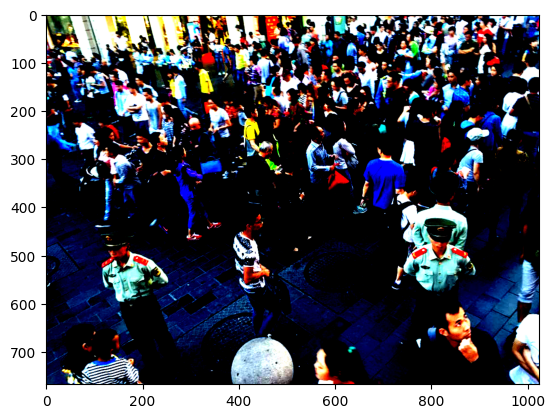

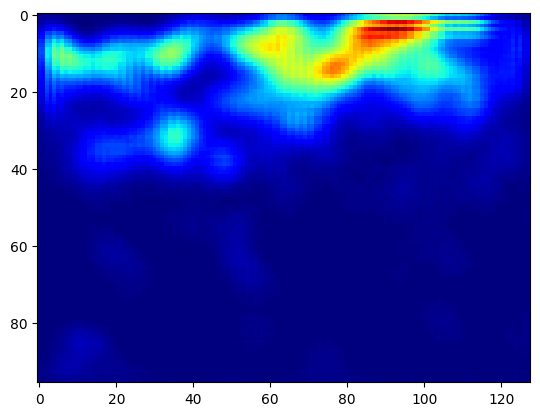

testing/IMG_28.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  8.0


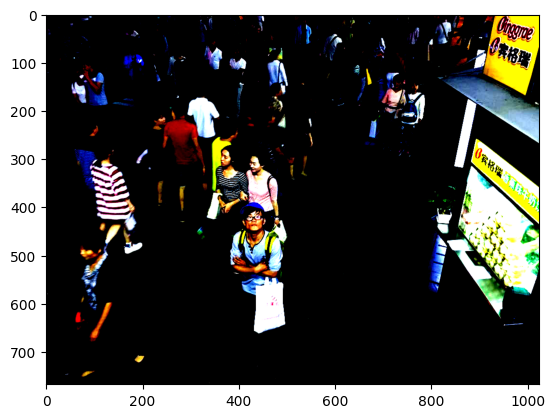

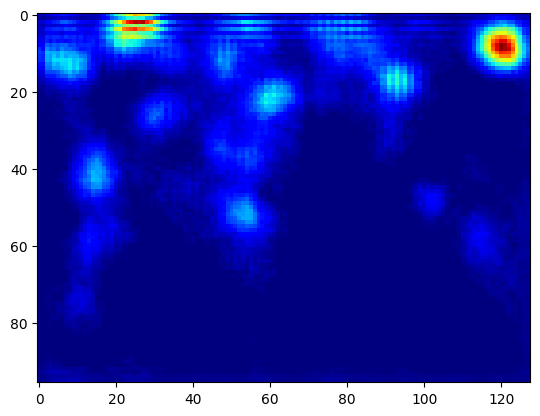

testing/IMG_29.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  34.0


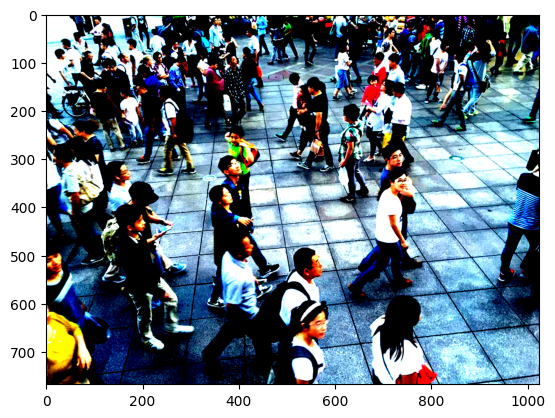

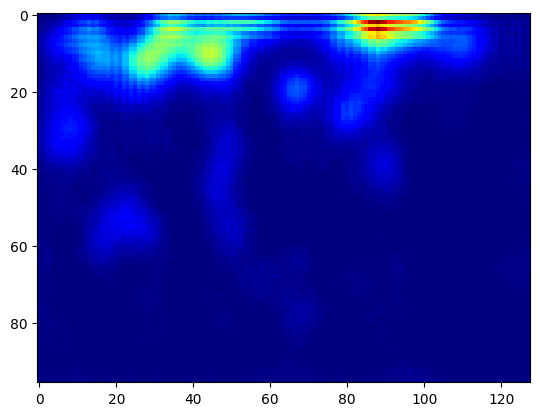

testing/IMG_30.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  19.0


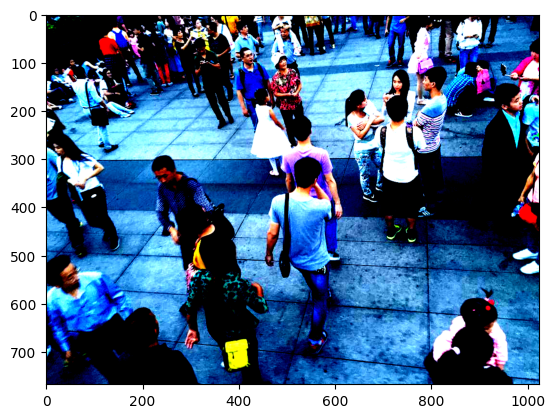

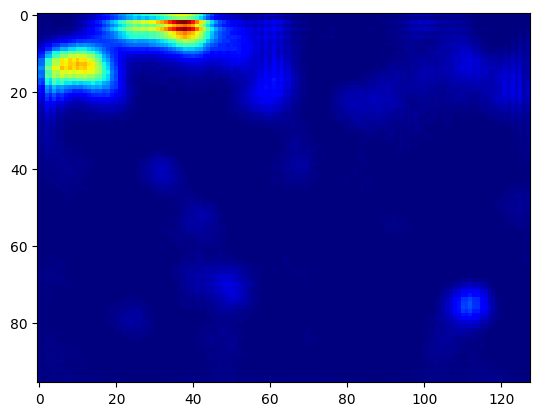

testing/IMG_31.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  62.0


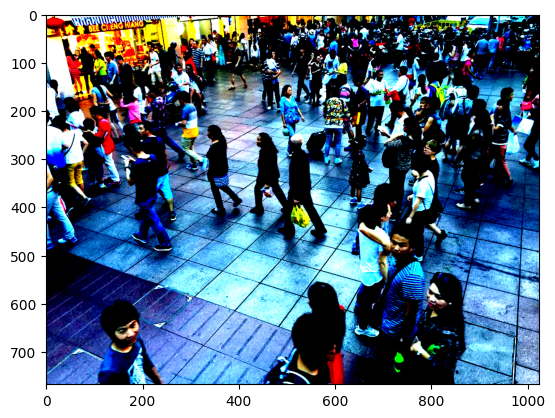

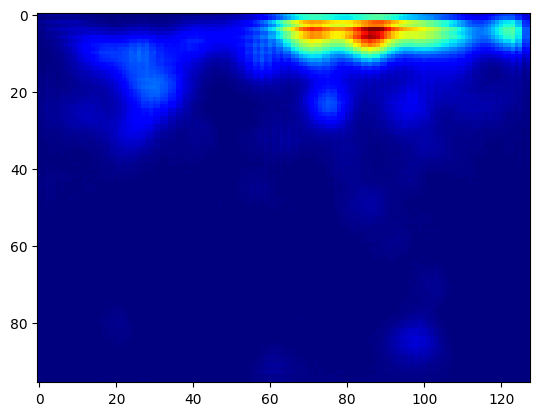

testing/IMG_32.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  7.0


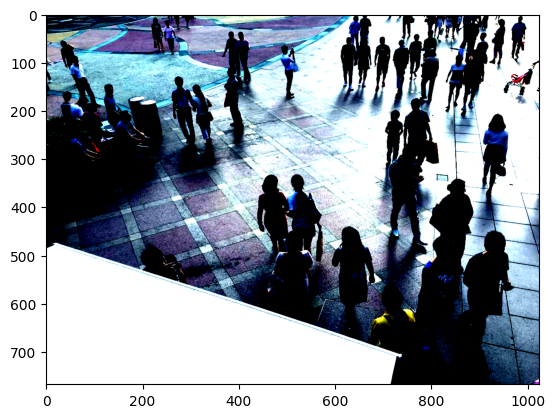

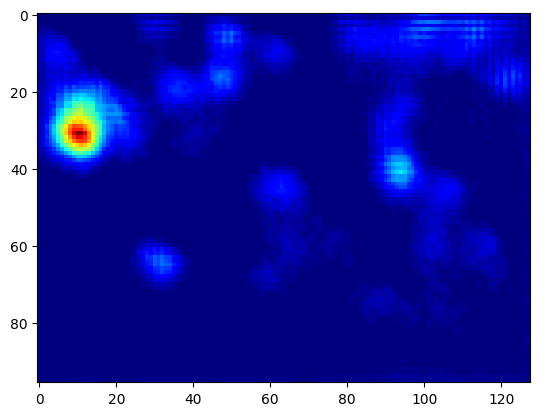

testing/IMG_33.jpg
1/1 [==============================] - 3s 3s/step
   predicted count =  51.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


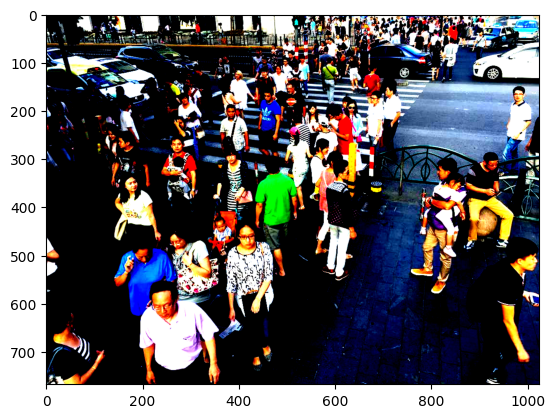

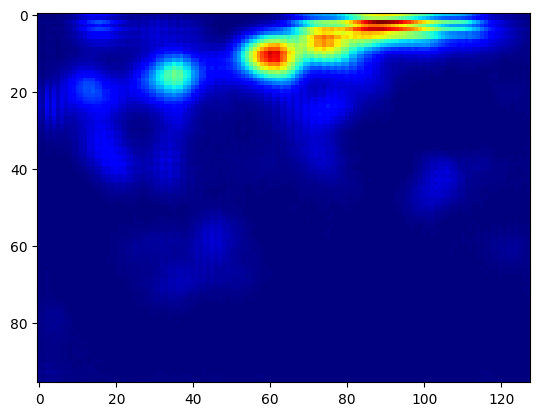

testing/IMG_34.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  16.0


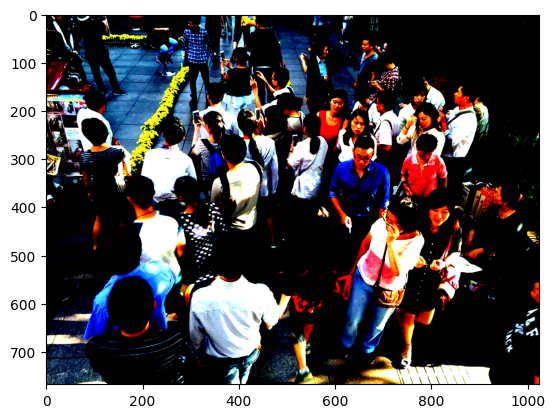

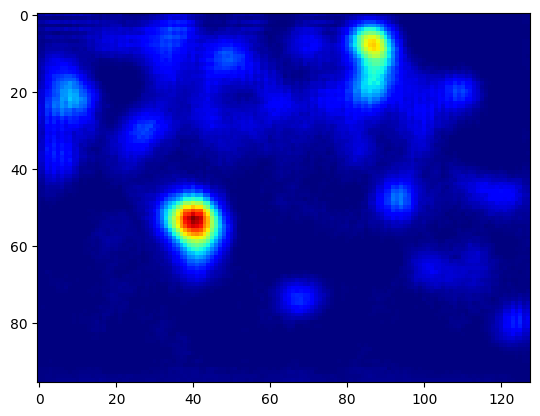

testing/IMG_35.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  34.0


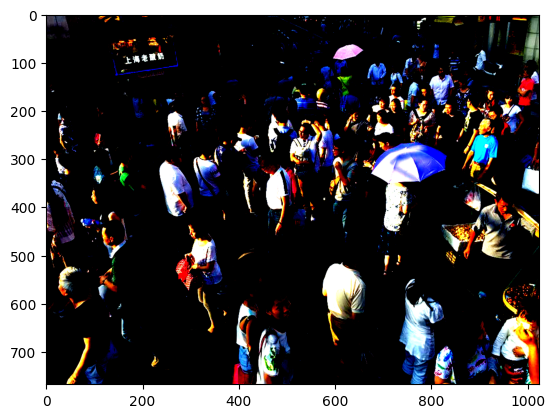

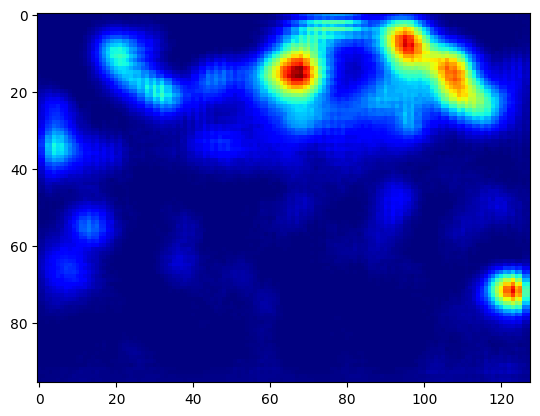

testing/IMG_36.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  63.0


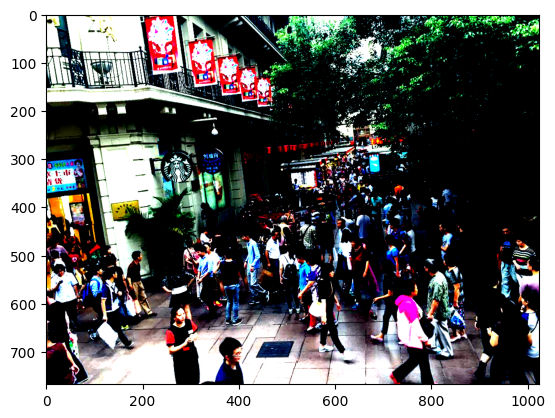

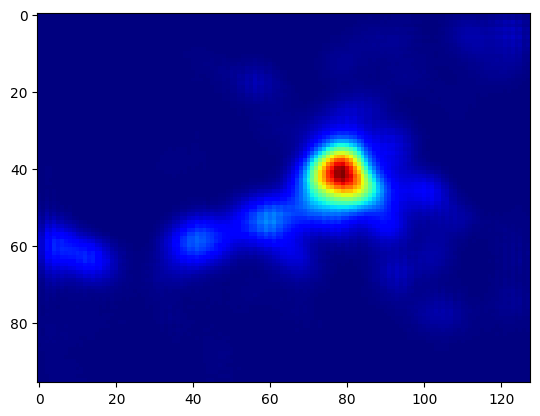

testing/IMG_37.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  9.0


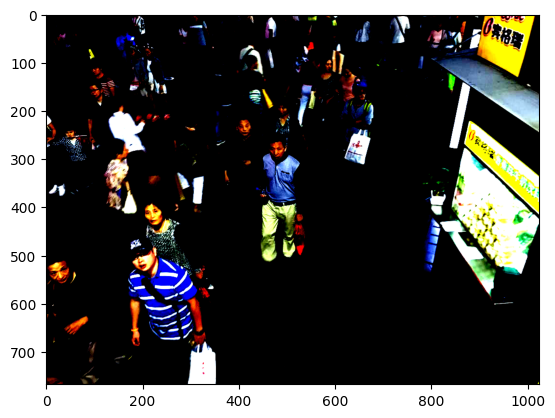

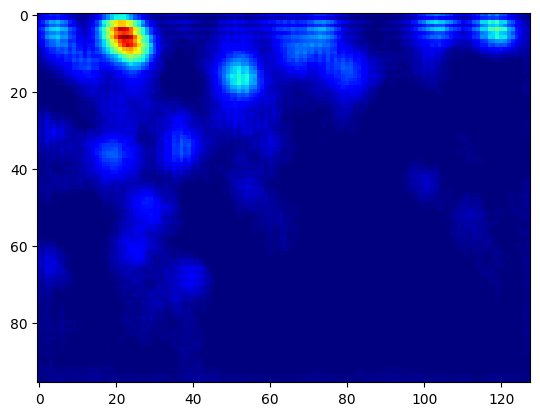

testing/IMG_38.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  17.0


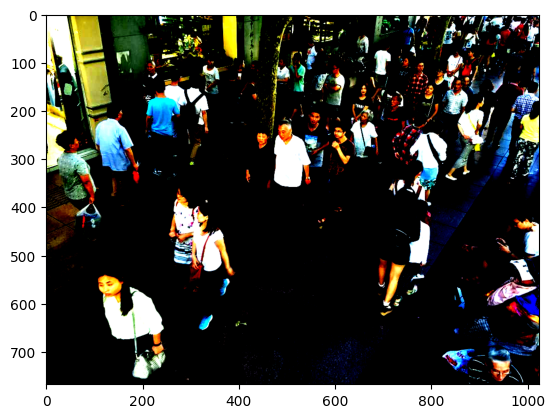

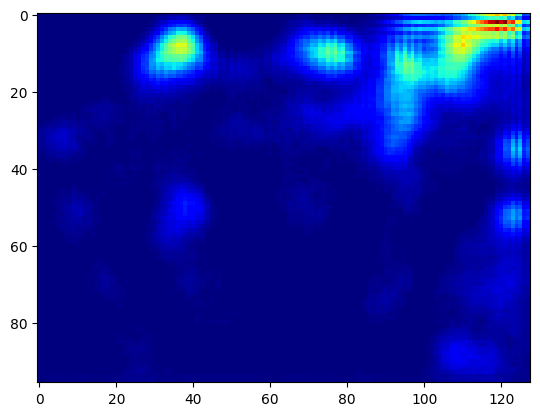

testing/IMG_39.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  16.0


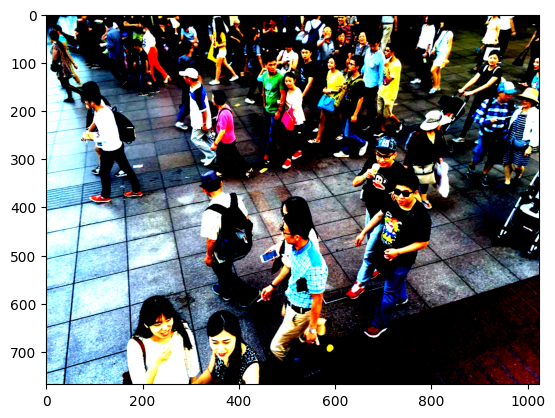

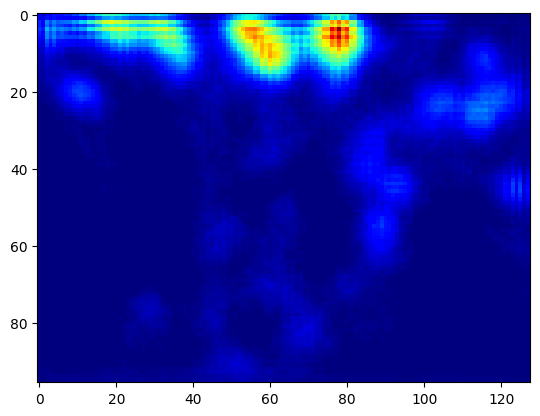

testing/IMG_40.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  85.0


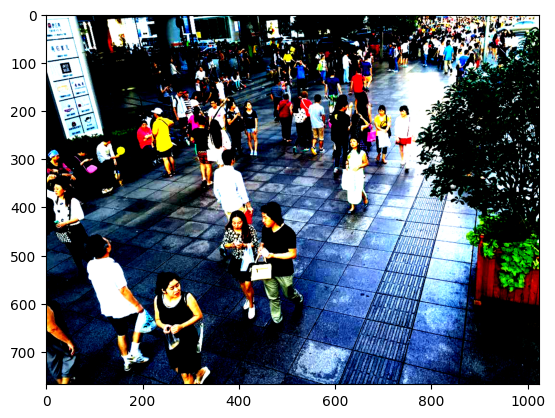

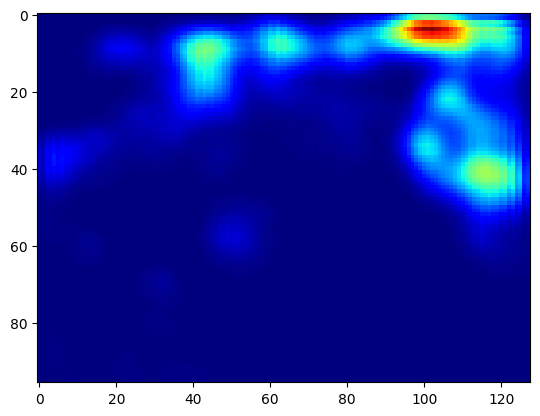

testing/IMG_41.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  11.0


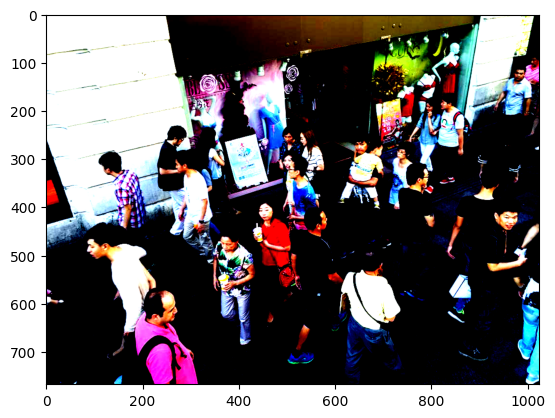

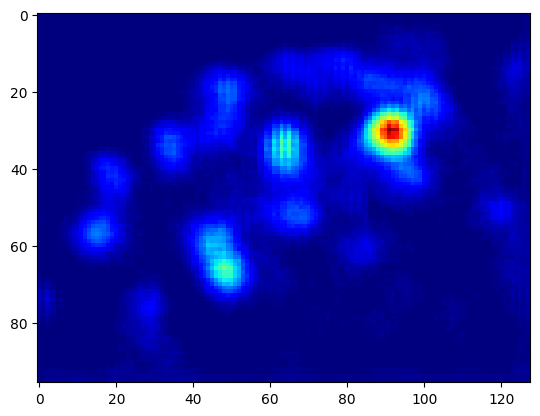

testing/IMG_42.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  11.0


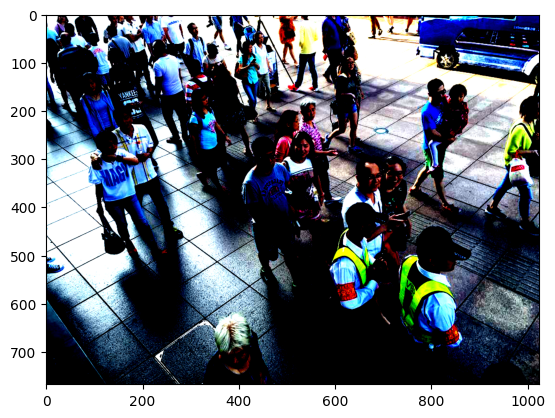

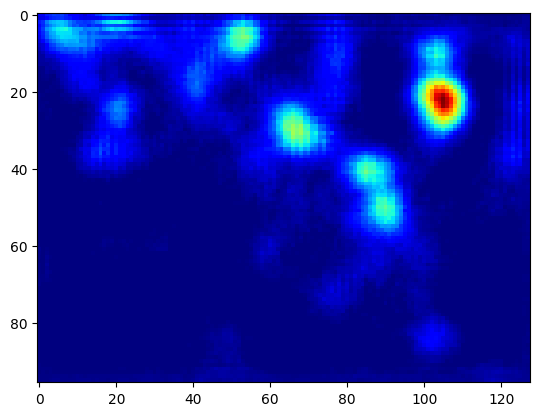

testing/IMG_43.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  27.0


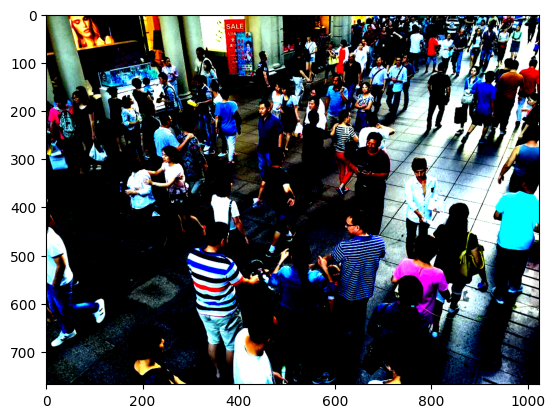

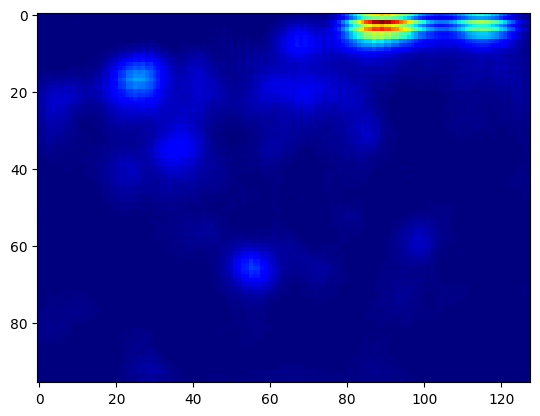

testing/IMG_44.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  7.0


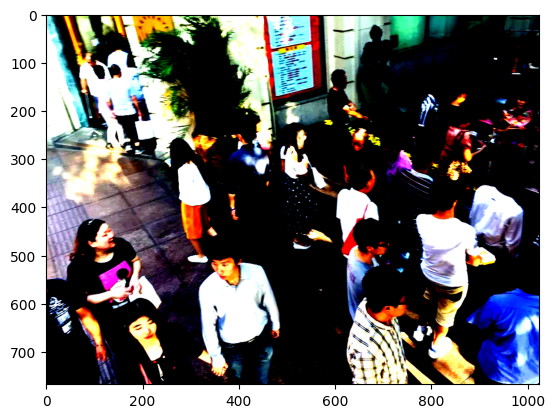

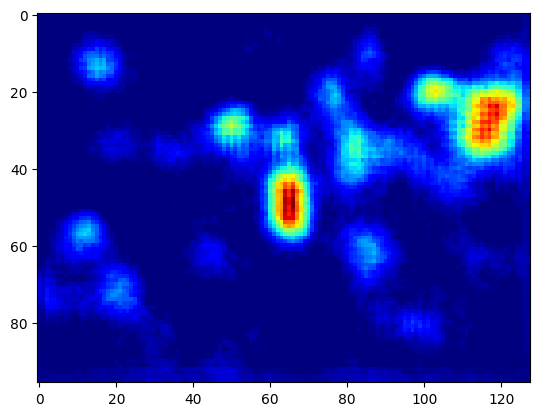

testing/IMG_45.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  51.0


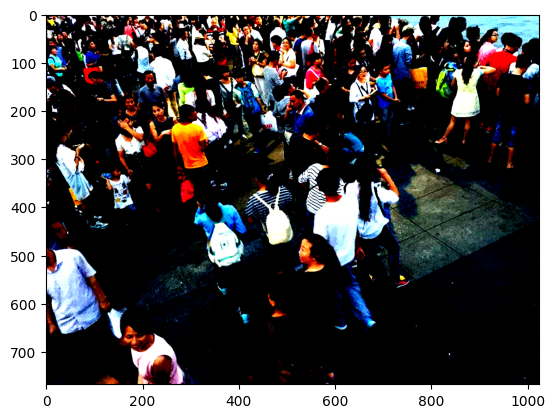

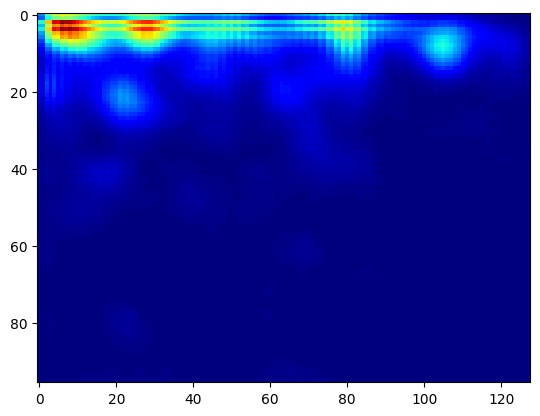

testing/IMG_46.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  40.0


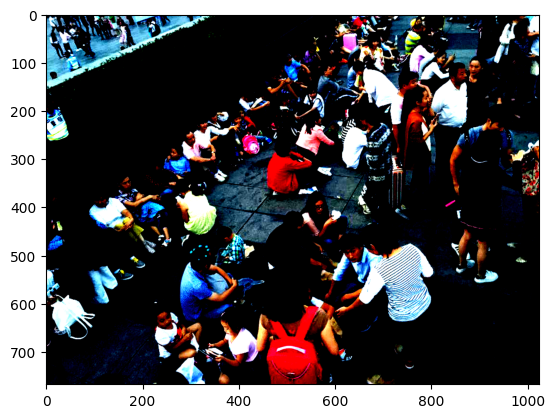

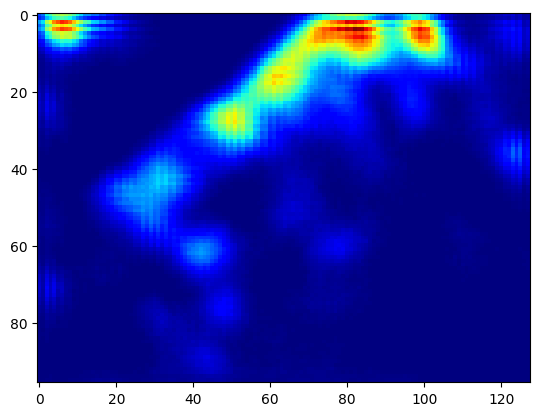

testing/IMG_47.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  23.0


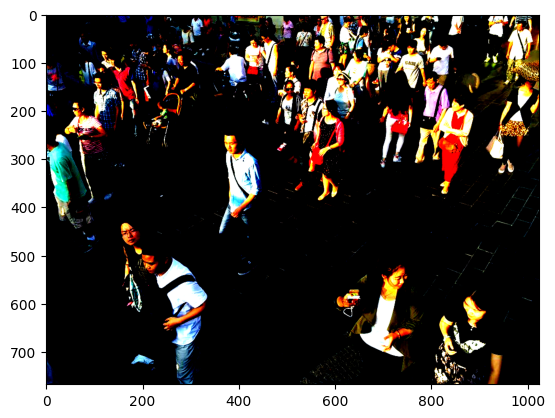

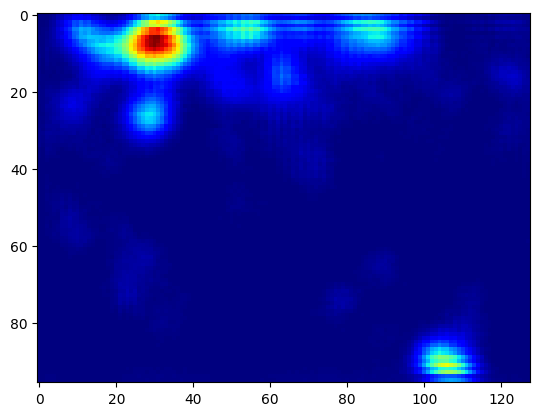

testing/IMG_48.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  32.0


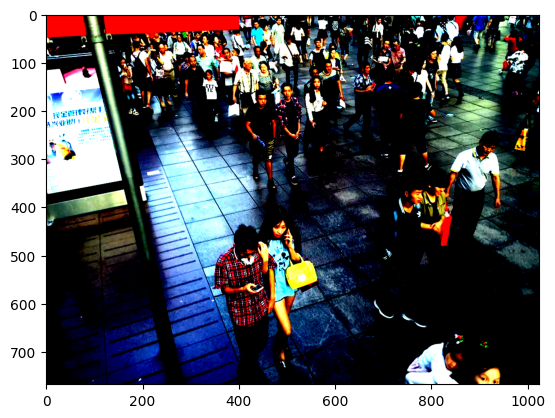

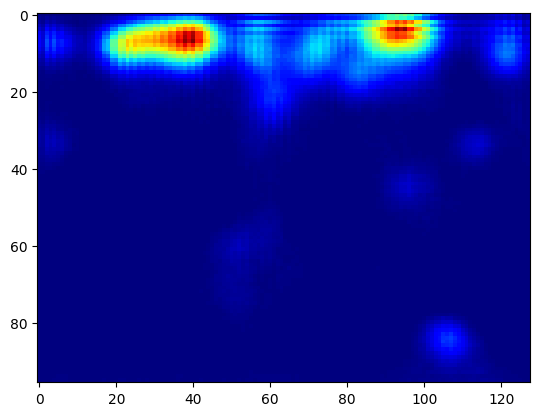

testing/IMG_49.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  15.0


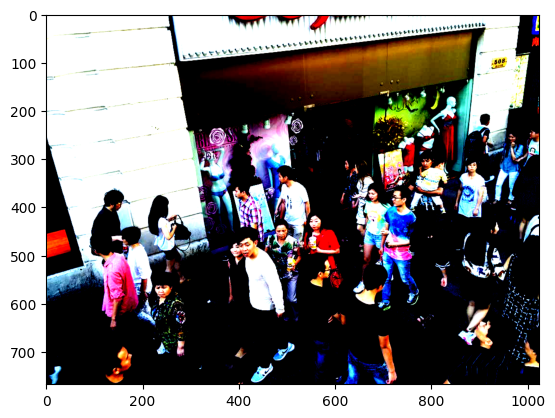

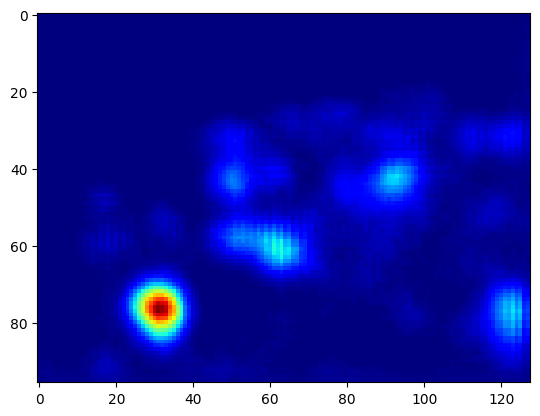

testing/IMG_50.jpg
1/1 [==============================] - 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


   predicted count =  86.0


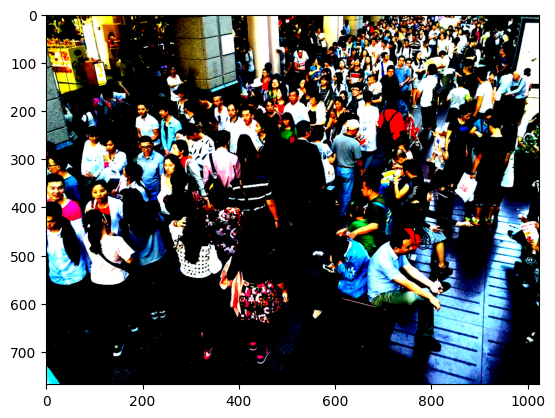

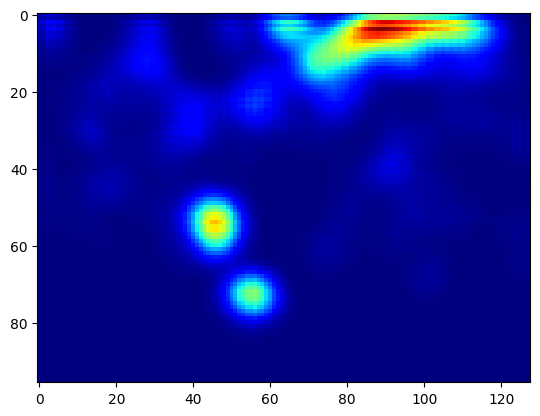

In [43]:
# ans,img,hmap = predict('data/ShanghaiTech_A/test_data/images/IMG_100.jpg')
# %matplotlib.inline

true=np.array(x)
avg = np.mean(x)
pred=np.zeros(true.shape)
for i in range(1,51):
    ans,img,hmap = predict('testing/IMG_'+str(i)+'.jpg')
    print("   predicted count = ",np.floor(ans))
    pred[i-1]=ans
    #Print count, image, heat map
    plt.imshow(img.reshape(img.shape[1],img.shape[2],img.shape[3]))
    plt.show()
    plt.imshow(hmap.reshape(hmap.shape[1],hmap.shape[2]) , cmap = c.jet )
    plt.show()
# ans, img, hmap = predict('test_images/IMG_100.jpg')

In [53]:
pred_val = pred_val + np.sum(pred)
true_val =np.sum(true)

In [54]:
print("accuracy = ",pred_val/true_val)
print("mae  = ",np.sum(np.abs(true - pred))/50)

accuracy =  0.5097441111675987
mae  =  83.54


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


263.0


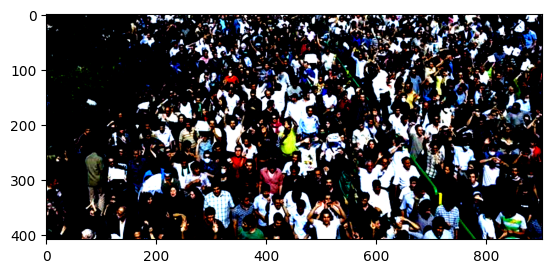

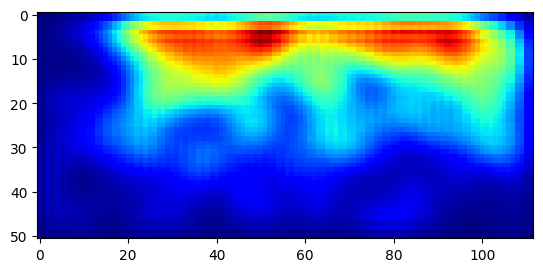

In [12]:

# print(np.floor(ans))
# #Print count, image, heat map
# plt.imshow(img.reshape(img.shape[1],img.shape[2],img.shape[3]))
# plt.show()
# plt.imshow(hmap.reshape(hmap.shape[1],hmap.shape[2]) , cmap = c.jet )
# plt.show()


In [13]:
temp = h5py.File('data/ShanghaiTech_A/test_data/ground/IMG_100.h5' , 'r')
temp_1 = np.asarray(temp['density'])
#plt.imshow(temp_1,cmap = c.jet)
print("Original Count : ",int(np.sum(temp_1)) + 1)

Original Count :  382
